<a href="https://colab.research.google.com/github/shiyaamsunder/bda/blob/MD5zee/UDIDFINAl.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [56]:
import pandas as pd
import numpy as np
from scipy import stats

# Read the CSV file
df = pd.read_csv('/content/UDIDDATA.csv')

print(df)

           state_name district_name     disability_type  age_lower  age_upper  \
0         Maharashtra      Yavatmal  Acid Attack Victim         35         60   
1         Maharashtra      Yavatmal  Acid Attack Victim         60         80   
2             Haryana   Yamunanagar  Acid Attack Victim         15         35   
3             Haryana   Yamunanagar  Acid Attack Victim         35         60   
4           Karnataka        Yadgir  Acid Attack Victim         15         35   
...               ...           ...                 ...        ...        ...   
52941   Uttar Pradesh          Agra         Thalassemia          6         15   
52942   Uttar Pradesh          Agra         Thalassemia         15         35   
52943  Madhya Pradesh    Agar Malwa         Thalassemia          0          6   
52944  Madhya Pradesh    Agar Malwa         Thalassemia          6         15   
52945  Madhya Pradesh    Agar Malwa         Thalassemia         15         35   

       Male_count  female_c

In [57]:

df.groupby(['state_name', 'district_name', 'disability_type', 'age_lower', 'age_upper']).sum()

Male_count  \
state_name                  district_name     disability_type         age_lower age_upper               
Andaman And Nicobar Islands Nicobars          Acid Attack Victim      35        60                  0   
                                              Blindness               6         15                  1   
                                                                      15        35                  2   
                                                                      35        60                 16   
                                                                      60        80                  3   
...                                                                                               ...   
West Bengal                 Paschim Bardhaman Hearing Impairment      6         15                  0   
                                              Intellectual Disability 6         15                  1   
                                              Mental Illness          15        35                  2   
                                              Multiple Disability     15        35                  1   
                            Purulia           Intellectual Disability 15        35                  1   

                                                                                           female_count  \
state_name                  district_name     disability_type         age_lower age_upper                 
Andaman And Nicobar Islands Nicobars          Acid Attack Victim      35        60                    1   
                                              Blindness               6         15                    1   
                                                                      15        35                    0   
                                                                      35        60                    4   
                                                                      60        80                    1   
...                                                                                                 ...   
West Bengal                 Paschim Bardhaman Hearing Impairment      6         15                    1   
                                              Intellectual Disability 6         15                    0   
                                              Mental Illness          15        35                    0   
                                              Multiple Disability     15        35                    0   
                            Purulia           Intellectual Disability 15        35                    0   

                                                                                           total  
state_name                  district_name     disability_type         age_lower age_upper         
Andaman And Nicobar Islands Nicobars          Acid Attack Victim      35        60             1  
                                              Blindness               6         15             2  
                                                                      15        35             2  
                                                                      35        60            20  
                                                                      60        80             4  
...                                                                                          ...  
West Bengal                 Paschim Bardhaman Hearing Impairment      6         15             1  
                                              Intellectual Disability 6         15             1  
                                              Mental Illness          15        35             2  
                                              Multiple Disability     15        35             1  
                            Purulia           Intellectual Disability 15        35             1  

[52946 rows x 3 columns]

In [58]:
!pip install plotly



In [62]:
# Drop rows with missing values
df = df.dropna()

# Create new features for male and female ratios
df['male_ratio'] = df['Male_count'] / df['total']
df['female_ratio'] = df['female_count'] / df['total']

# Define features (X) and target variable (y)
X = df[['age_lower', 'age_upper', 'male_ratio', 'female_ratio']]
y = df['disability_type']

# Split the data into training and testing sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25)


In [65]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

# Initialize the model
model = DecisionTreeClassifier()

# Train the model on the training set
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.14111958903074714


In [64]:
df = df.drop(['state_name', 'district_name', 'disability_type'], axis=1)

In [67]:
print(df)

       age_lower  age_upper  Male_count  female_count  total  male_ratio  \
0             35         60           1             0      1    1.000000   
1             60         80           0             1      1    0.000000   
2             15         35           1             0      1    1.000000   
3             35         60           4             0      4    1.000000   
4             15         35           5             8     13    0.384615   
...          ...        ...         ...           ...    ...         ...   
52941          6         15           2             0      2    1.000000   
52942         15         35           5             4      9    0.555556   
52943          0          6           1             0      1    1.000000   
52944          6         15           1             0      1    1.000000   
52945         15         35           4             0      4    1.000000   

       female_ratio  
0          0.000000  
1          1.000000  
2          0.000000  

<Axes: xlabel='age_upper'>

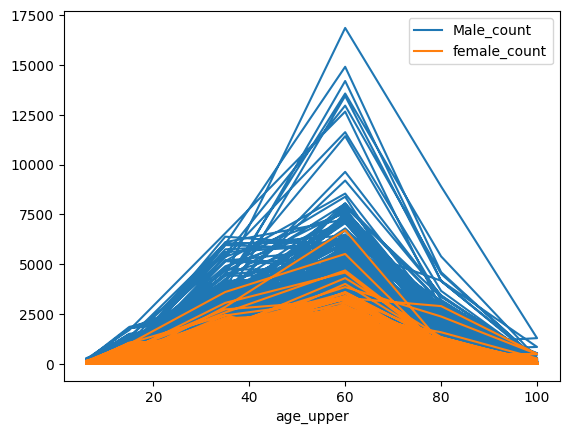

In [68]:
# prompt: Using dataframe df: plot with some graph

df.plot.scatter(x='age_upper', y='male_ratio')


<Axes: xlabel='age_lower'>

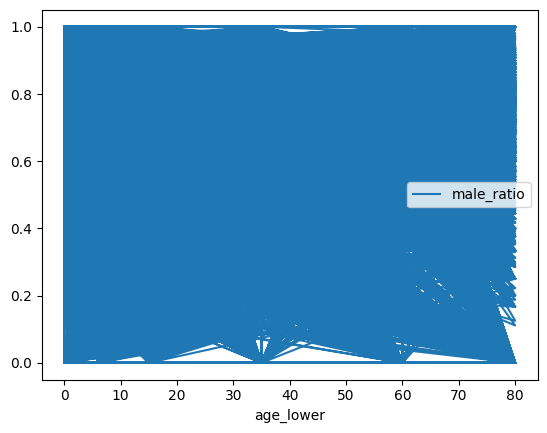

In [69]:
df.plot(x='age_lower', y='male_ratio')

<Axes: xlabel='male_ratio', ylabel='female_ratio'>

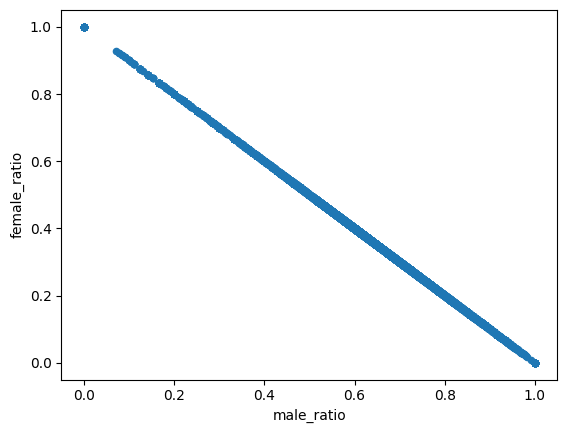

In [70]:

df.plot.scatter(x='male_ratio', y='female_ratio')

<Axes: xlabel='age_upper', ylabel='male_ratio'>

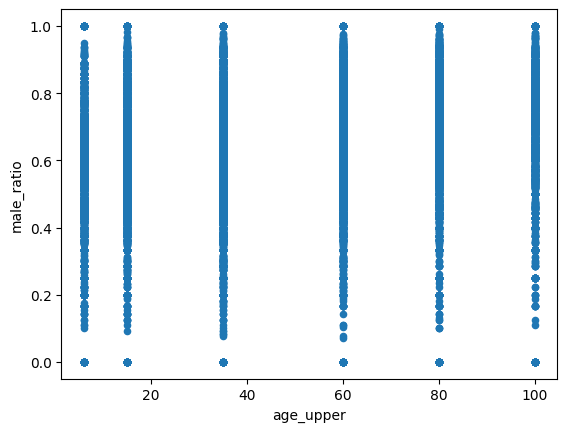

In [71]:
# prompt: Using dataframe df: plot with some graph

df.plot.scatter(x='age_upper', y='male_ratio')

In [72]:
df = pd.read_csv('/content/UDIDDATA.csv')

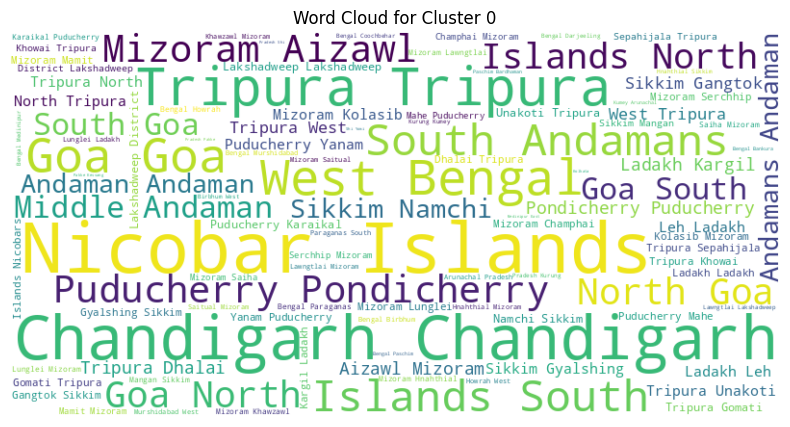

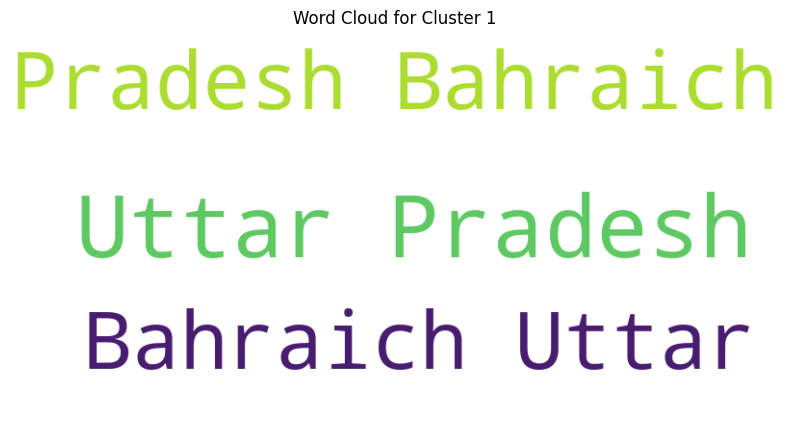

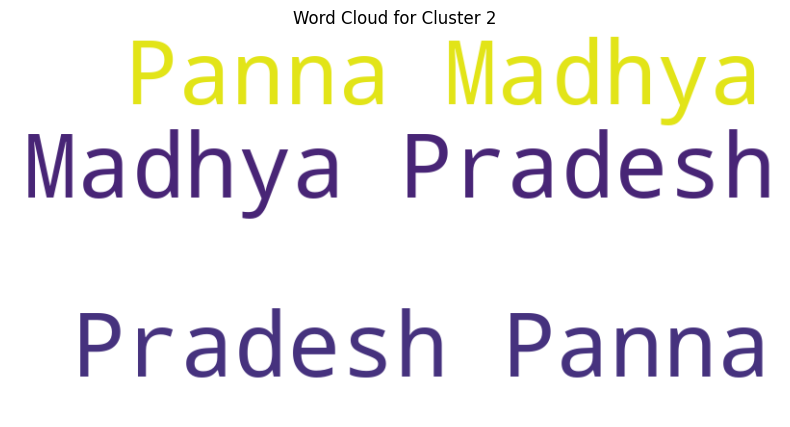

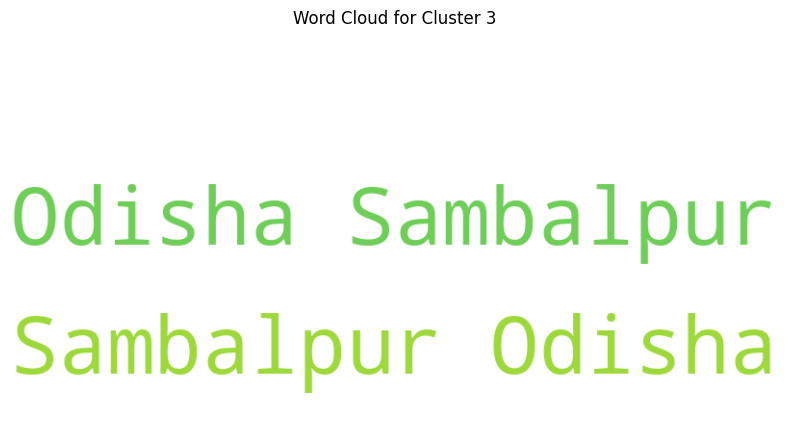

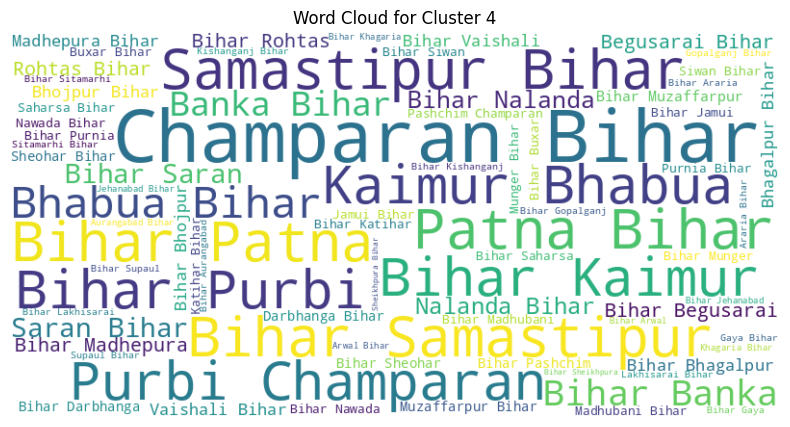

...

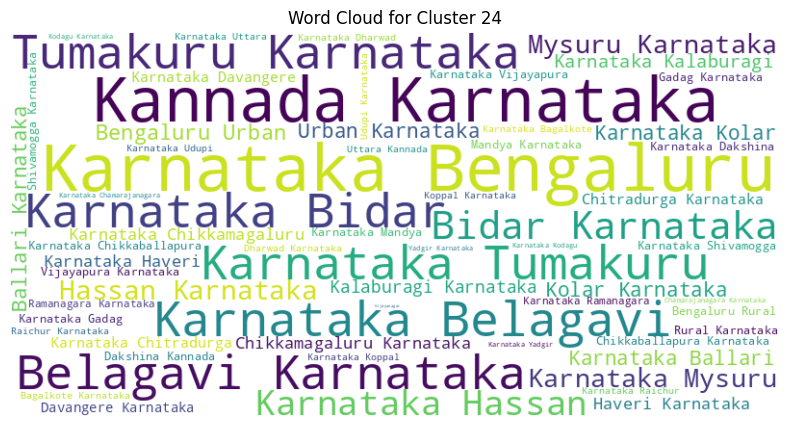

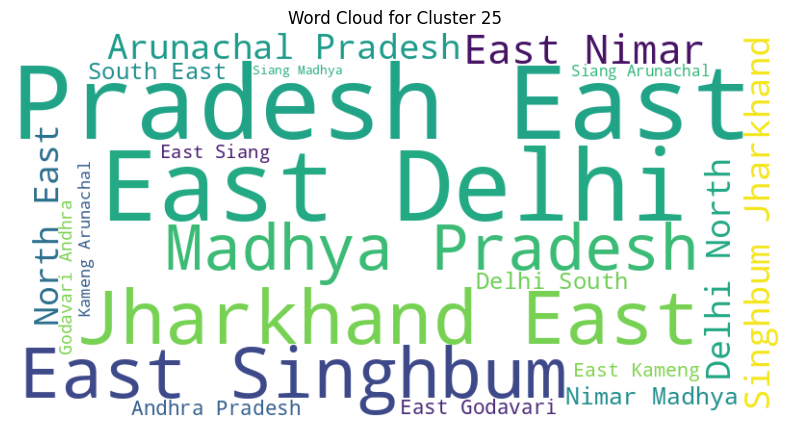

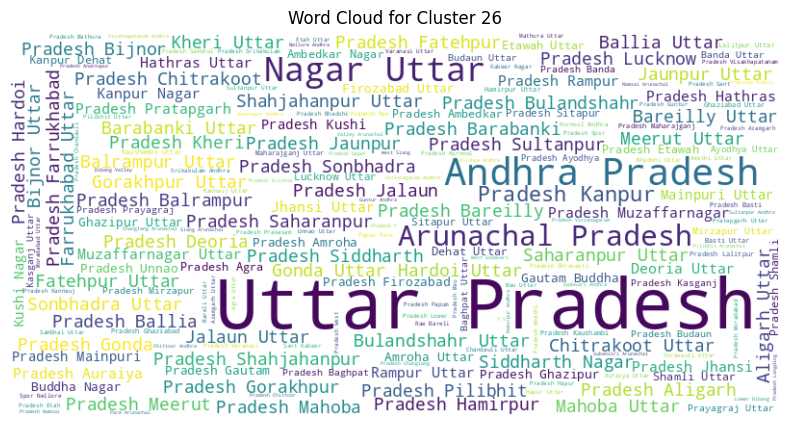

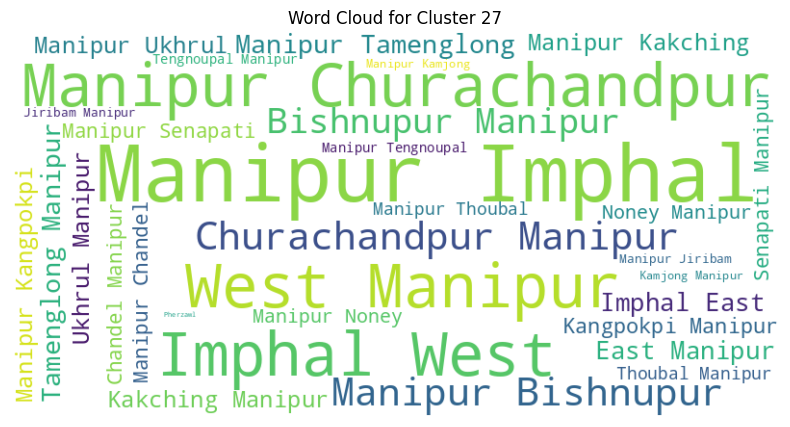

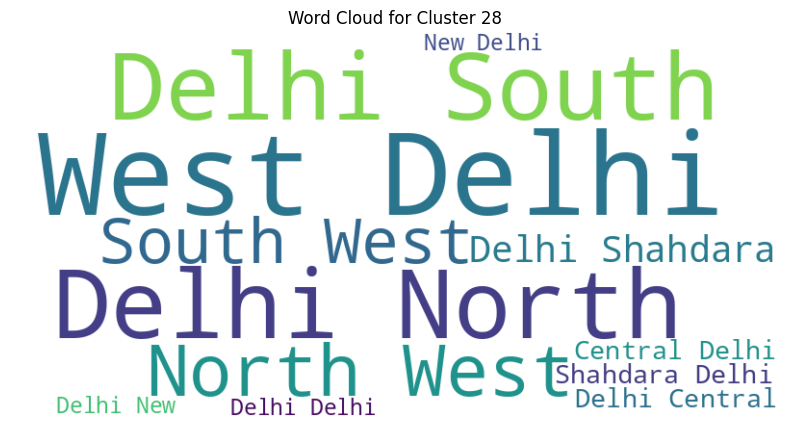

In [75]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Assuming 'df' is your DataFrame with 'state_name' and 'district_name' columns
# Concatenate 'state_name' and 'district_name' to create text for vectorization
df['text'] = df['state_name'] + ' ' + df['district_name']

# Vectorize the text using TfidfVectorizer
vectorizer = TfidfVectorizer(stop_words='english')
X = vectorizer.fit_transform(df['text'])

# Apply k-means clustering
num_clusters = 29  # You can adjust the number of clusters as needed
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
df['cluster'] = kmeans.fit_predict(X)

# Generate a word cloud for each cluster
for cluster_id in range(num_clusters):
    cluster_text = ' '.join(df[df['cluster'] == cluster_id]['text'])
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(cluster_text)

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'Word Cloud for Cluster {cluster_id}')
    plt.axis('off')
    plt.show()


In [78]:
!pip install geopandas


In [110]:
df = pd.read_csv('/content/UDIDDATA.csv')


In [124]:
!pip install plotly --user

In [125]:
import json
import numpy as np
import pandas as pd
import plotly.express as px


In [126]:
import plotly.io as pio
pio.renderers.default = 'browser'

In [127]:
india_states = json.load(open("/content/states_india.geojson", "r"))

In [128]:
state_id_map = {}
for feature in india_states["features"]:
    feature["id"] = feature["properties"]["state_code"]
    state_id_map[feature["properties"]["st_nm"]] = feature["id"]

In [129]:
df = pd.read_csv("/content/india_census.csv")
df["Density"] = df["Density[a]"].apply(lambda x: int(x.split("/")[0].replace(",", "")))
df["id"] = df["State or union territory"].apply(lambda x: state_id_map[x])

In [130]:
df.head()

,Rank,State or union territory,Population,Population (%),Decadal growth(2001–2011),Rural population,Percent rural,Urban population,Percent urban,Area[16],Density[a],Sex ratio,Density,id
0,1.0,Uttar Pradesh,199812341,NaN,20.20%,155317278,NaN,44495063,NaN,"240,928 km2 (93,023 sq mi)","828/km2 (2,140/sq mi)",912,828,9
1,2.0,Maharashtra,112374333,NaN,20.00%,61556074,NaN,50818259,NaN,"307,713 km2 (118,809 sq mi)",365/km2 (950/sq mi),929,365,27
2,3.0,Bihar,104099452,NaN,25.40%,92341436,NaN,11758016,NaN,"94,163 km2 (36,357 sq mi)","1,102/km2 (2,850/sq mi)",918,1102,10
3,4.0,West Bengal,91276115,NaN,13.80%,62183113,NaN,29093002,NaN,"88,752 km2 (34,267 sq mi)","1,029/km2 (2,670/sq mi)",953,1029,19
4,5.0,Madhya Pradesh,72626809,NaN,16.30%,52557404,NaN,20069405,NaN,"308,245 km2 (119,014 sq mi)",236/km2 (610/sq mi),931,236,23


<Axes: >

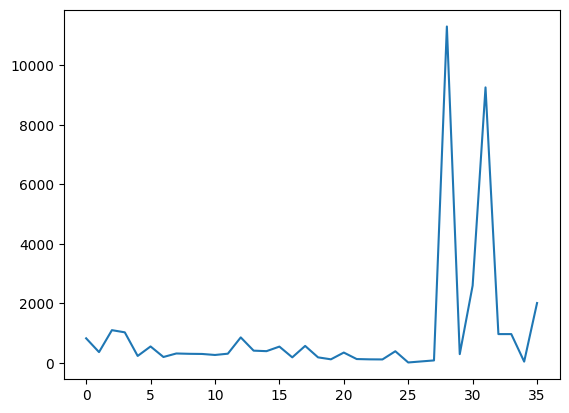

In [131]:
df["Density"].plot()

In [132]:
df["DensityScale"] = np.log10(df["Density"])

<Axes: >

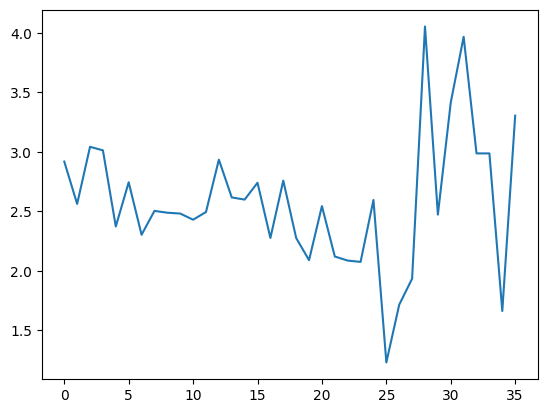

In [133]:
df["DensityScale"].plot()

In [134]:


fig = px.choropleth(df,locations="id",geojson=india_states,color="DensityScale",hover_name="State or union territory",hover_data=["Density"],title="India Population Density",)
fig.update_geos(fitbounds="locations", visible=False)
import plotly.io as pio

pio.write_html(fig, file='plot.html', auto_open=True)




In [135]:
from IPython.display import HTML

# Assuming 'plot.html' is the name of your HTML file
HTML(filename='plot.html')


In [139]:
fig = px.choropleth_mapbox(
    df,
    locations="id",
    geojson=india_states,
    color="DensityScale",
    hover_name="State or union territory",
    hover_data=["Density"],
    title="India Population Density",
    mapbox_style="carto-positron",
    center={"lat": 24, "lon": 78},
    zoom=3,
    opacity=0.5,
)
import plotly.io as pio

pio.write_html(fig, file='plot2.html', auto_open=True)


In [140]:
HTML(filename='plot2.html')

In [141]:
df["SexRatioScale"] = df["Sex ratio"] - 1000

In [142]:
fig = px.choropleth(
    df,
    locations="id",
    geojson=india_states,
    color="SexRatioScale",
    hover_name="State or union territory",
    hover_data=["Sex ratio"],
    title="India Sex Ratio",
    color_continuous_scale=px.colors.diverging.BrBG,
    color_continuous_midpoint=0,
)
fig.update_geos(fitbounds="locations", visible=False)
import plotly.io as pio

pio.write_html(fig, file='plot3.html', auto_open=True)


In [143]:
HTML(filename='plot3.html')